# loading libraries

In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import pathlib
import darts
from darts.models.forecasting.arima import ARIMA
from darts import TimeSeries
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller
import os
import glob
from tqdm import tqdm
from darts.dataprocessing.transformers.scaler import Scaler



# Helping Functions


In [16]:
import numpy as np

def calculate_metrics(actual, predicted):
    # Convert inputs to numpy arrays for easier calculations
    actual = np.array(actual)
    predicted = np.array(predicted)
    
    # Calculate individual metrics
    mae = np.mean(np.abs(predicted - actual))
    rmse = np.sqrt(np.mean((predicted - actual) ** 2))
    mape = np.mean(np.abs((predicted - actual) / actual)) * 100
    mse = np.mean((predicted - actual) ** 2)
    
    metrics = {
        'MAE': mae,
        'RMSE': rmse,
        'MAPE': mape,
        'MSE': mse
    }
    
    return metrics


# Selected Time Store_Number % family
## Records
* Store Number : 1 & Family : Automative 
* Store Number : 2 & Family :Automative
* Store Number : 3 & Family :Automative
* Store Number : 7 & Family :Automative
* Store Number : 1 & Family : Seafood

In [17]:
fileName = '2_AUTOMOTIVE'
df = pd.read_csv(f'../ProcessedData/GroupData/{fileName}.csv')
df.head()


,date,id,store_nbr,family,sales,onpromotion,transactions,holiday_type,locale,locale_name,...,dcoilwtico,city,state,store_type,cluster,year,month,day_of_month,day_of_week,day_name
0,2013-01-02,2145,2,AUTOMOTIVE,8.0,0,2358,NaN,NaN,NaN,...,93.14,Quito,Pichincha,D,13,2013,1,2,2,Wednesday
1,2013-01-03,3927,2,AUTOMOTIVE,5.0,0,2033,NaN,NaN,NaN,...,92.97,Quito,Pichincha,D,13,2013,1,3,3,Thursday
2,2013-01-04,5709,2,AUTOMOTIVE,3.0,0,2066,NaN,NaN,NaN,...,93.12,Quito,Pichincha,D,13,2013,1,4,4,Friday
3,2013-01-05,7491,2,AUTOMOTIVE,5.0,0,2062,Work Day,National,Ecuador,...,NaN,Quito,Pichincha,D,13,2013,1,5,5,Saturday
4,2013-01-06,9273,2,AUTOMOTIVE,6.0,0,1992,NaN,NaN,NaN,...,NaN,Quito,Pichincha,D,13,2013,1,6,6,Sunday


In [18]:
df = df[['date','sales']]
df = df.drop_duplicates()
df.head()

,date,sales
0,2013-01-02,8.0
1,2013-01-03,5.0
2,2013-01-04,3.0
3,2013-01-05,5.0
4,2013-01-06,6.0


# stationary Tesst

In [19]:
def adfuller_test(values):
    result=adfuller(values)
    labels = ['ADF Test Statistic','p-value','#Lags Used','Number of Observations Used']
    for value,label in zip(result,labels):
        print(label+' : '+str(value) )
    if result[1] <= 0.05:
        print("P value is less than 0.05 that means we can reject the null hypothesis(Ho). Therefore we can conclude that data has no unit root and is stationary")
    else:
        print("Weak evidence against null hypothesis that means time series has a unit root which indicates that it is non-stationary ")


In [20]:
adfuller_test(df['sales'])

ADF Test Statistic : -7.010459174007073
p-value : 6.943453886358411e-10
#Lags Used : 6
Number of Observations Used : 580
P value is less than 0.05 that means we can reject the null hypothesis(Ho). Therefore we can conclude that data has no unit root and is stationary


## Spliting Data into Training & Testing Data

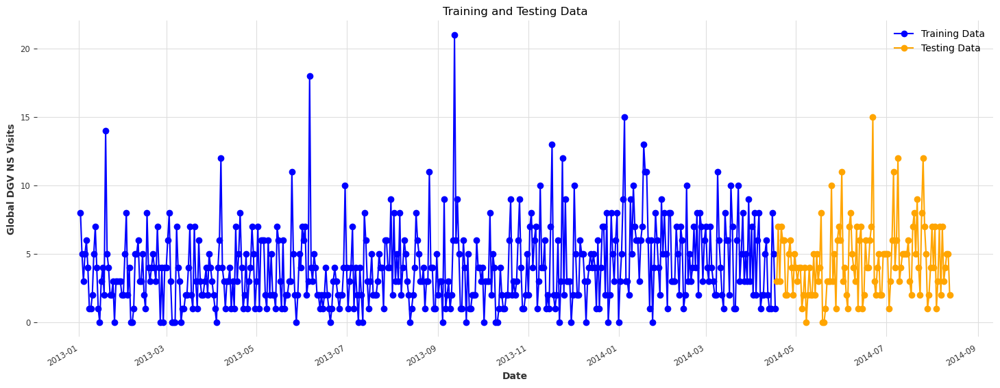

In [21]:
from darts import TimeSeries
import numpy as np
import matplotlib.pyplot as plt

# Assuming df is your DataFrame containing daily data
series = TimeSeries.from_dataframe(df, "date", "sales", freq='1D', fill_missing_dates=True, fillna_value=0)


split_point = 0.80

train_series, test_series = series.split_after(split_point)

# Set the figure size and style
plt.figure(figsize=(18, 6))
# Plot the training and testing data
train_series.plot(label='Training Data', color='blue', linewidth=1.5, marker='o')
test_series.plot(label='Testing Data', color='orange', linewidth=1.5, marker='o')

# Add title and labels
plt.title('Training and Testing Data')
plt.xlabel('Date')
plt.ylabel('Global DGV NS Visits')

# Add grid lines
plt.grid(True)

# Add legend
plt.legend()

# Display the plot
plt.show()


## Inspect Seasonality

In [22]:
from darts.utils.statistics import plot_acf, check_seasonality

for m in range(2, 25):
    is_seasonal, period = check_seasonality(train_series, m=m, alpha=0.05)
    if is_seasonal:
        print("There is seasonality of order {}.".format(period))

There is seasonality of order 7.
There is seasonality of order 9.
There is seasonality of order 12.
There is seasonality of order 14.
There is seasonality of order 21.


## Auto Correlation plot
The autocorrelation function (ACF) is used to identify the order of ARIMA models. The ACF plot shows the correlation between the time series and its lagged version. The lag at which the ACF plot crosses the upper confidence interval for the first time is considered as the order of the **MA** component of the ARIMA model. Similarly, if the ACF plot decays slowly, it indicates that there is a high degree of autocorrelation in the time series, which means that an AR component should be included in the ARIMA model.

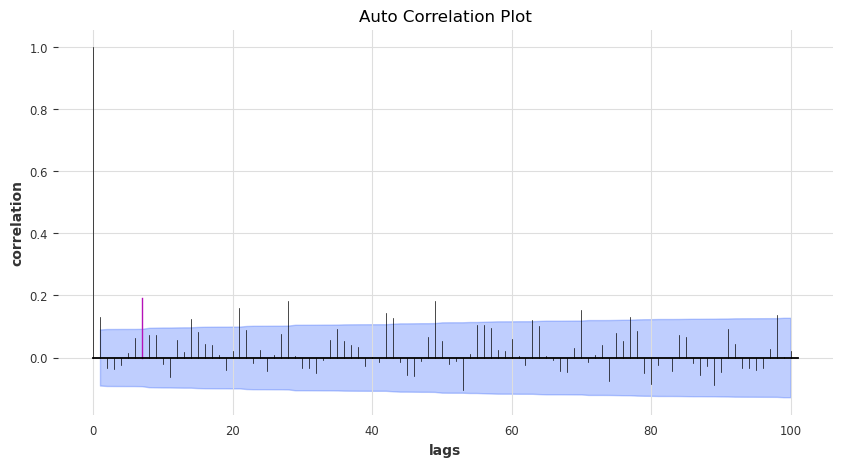

In [23]:
from darts.utils.statistics import plot_acf,plot_pacf


plot_acf(train_series, m=7, max_lag=100,  fig_size=(10, 5), axis=None, default_formatting=True)
plt.xlabel('lags')
plt.ylabel('correlation')
plt.title('Auto Correlation Plot')
plt.show()

## Partial Auto Correlation plot
The partial autocorrelation function (PACF) is also used to identify the order of ARIMA models. The PACF plot shows the correlation between the time series and its lagged version, but with the influence of the intermediate lags removed. The lag at which the PACF plot crosses the upper confidence interval for the first time is considered as the order of the **AR** component of the ARIMA model.

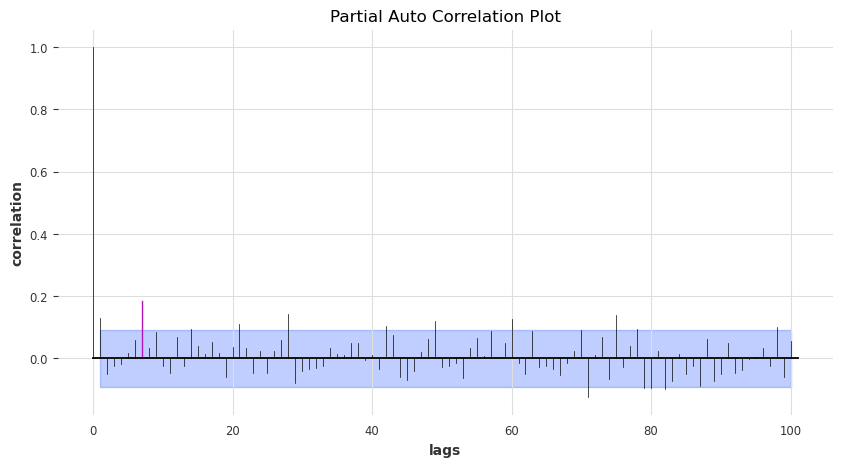

In [24]:
from darts.utils.statistics import plot_acf,plot_pacf
plot_pacf(train_series, m=7, max_lag=100,  fig_size=(10, 5), axis=None, default_formatting=True)

plt.xlabel('lags')
plt.ylabel('correlation')
plt.title('Partial Auto Correlation Plot')
plt.show()

# Model Fitting

## SARIMA Model

In [25]:

sarima_model = ARIMA(
    p=7,
    d=0, 
    q=7, 
    trend=None, 
    random_state=1999,
    seasonal_order=(2,1,2,7),
    add_encoders={
                'cyclic': {'future': ['month']},
                'datetime_attribute': {'future': ['hour', 'dayofweek']},
                'position': {'future': ['relative']},
                'custom': {'future': [lambda idx: (idx.year - 1950) / 50]},
                'transformer': Scaler()
            }
                                            ,
)

sarima_model.fit(train_series)
sarima_model.model.summary()

/home/iffi/anaconda3/envs/darts/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


<class 'statsmodels.iolib.summary.Summary'>
"""
                                       SARIMAX Results                                       
=============================================================================================
Dep. Variable:                                     y   No. Observations:                  471
Model:             ARIMA(7, 0, 7)x(2, 1, [1, 2], 14)   Log Likelihood               -1113.432
Date:                               Sun, 27 Aug 2023   AIC                           2276.864
Time:                                       19:28:46   BIC                           2379.981
Sample:                                            0   HQIC                          2317.480
                                               - 471                                         
Covariance Type:                                 opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.1491      0.311     -0.480      0.631      -0.758       0.460
x2             0.2118      0.204      1.037      0.300      -0.188       0.612
const       3.457e-16   1.89e+05   1.83e-21      1.000   -3.71e+05    3.71e+05
x3         -1.244e-06   1.87e+05  -6.66e-12      1.000   -3.66e+05    3.66e+05
x4            -0.0603      1.135     -0.053      0.958      -2.286       2.165
x5             1.4010      0.720      1.945      0.052      -0.011       2.813
ar.L1         -0.0223      1.652     -0.013      0.989      -3.260       3.215
ar.L2         -0.4408      1.350     -0.327      0.744      -3.087       2.205
ar.L3         -0.3901      1.121     -0.348      0.728      -2.588       1.808
ar.L4         -0.8382      0.171     -4.889      0.000      -1.174      -0.502
ar.L5          0.0204      1.405      0.015      0.988      -2.733       2.773
ar.L6         -0.4018      1.156     -0.348      0.728      -2.667       1.864
ar.L7         -0.3835      0.992     -0.387      0.699      -2.327       1.561
ma.L1          0.1105      1.643      0.067      0.946      -3.110       3.331
ma.L2          0.3864      1.436      0.269      0.788      -2.428       3.200
ma.L3          0.4045      1.156      0.350      0.726      -1.861       2.670
ma.L4          0.8516      0.222      3.833      0.000       0.416       1.287
ma.L5         -0.0164      1.369     -0.012      0.990      -2.700       2.667
ma.L6          0.3495      1.173      0.298      0.766      -1.949       2.648
ma.L7          0.4288      1.003      0.427      0.669      -1.538       2.395
ar.S.L14      -0.8999      0.367     -2.454      0.014      -1.619      -0.181
ar.S.L28      -0.1024      0.067     -1.531      0.126      -0.234       0.029
ma.S.L14      -0.0775      0.371     -0.209      0.834      -0.804       0.649
ma.S.L28      -0.7121      0.341     -2.089      0.037      -1.380      -0.044
sigma2         7.4037      0.467     15.859      0.000       6.489       8.319
===================================================================================
Ljung-Box (L1) (Q):                   0.03   Jarque-Bera (JB):               397.49
Prob(Q):                              0.87   Prob(JB):                         0.00
Heteroskedasticity (H):               1.31   Skew:                             1.20
Prob(H) (two-sided):                  0.10   Kurtosis:                         6.89
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 6.82e+14. Standard errors may be unstable.
"""

In [26]:

import os
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from tqdm import tqdm

# Function to predict and evaluate
def predict_and_evaluate(window_size, prediction_horizon, slide_step, test_series, arima_model,result_plot_path ):
    num_predictions = len(test_series) - window_size - prediction_horizon + 1
    
    meta_information_evaluation = {
        'Iterations': [],
        'MAE': [],
        'RMSE': [],
        'MAPE': [],
        'MSE': [],
        'input_window_size': [],
        'horizon': [],
        'stride': []
    }
    
    try:
        for i in tqdm(range(0, num_predictions, slide_step)):
            input_window = test_series[i:i + window_size]
            ground_truth = test_series[i + window_size:i + window_size + prediction_horizon]
            forecast = arima_model.predict(n=prediction_horizon, series=input_window)
            actual = ground_truth.values().flatten().tolist()
            predicted = forecast.values().flatten().tolist()
            metrics = calculate_metrics(actual, predicted)
            
            meta_information_evaluation['Iterations'].append(i)
            meta_information_evaluation['MAE'].append(metrics['MAE'])
            meta_information_evaluation['RMSE'].append(metrics['RMSE'])
            meta_information_evaluation['MAPE'].append(metrics['MAPE'])
            meta_information_evaluation['MSE'].append(metrics['MSE'])
            meta_information_evaluation['input_window_size'].append(window_size)
            meta_information_evaluation['horizon'].append(prediction_horizon)
            meta_information_evaluation['stride'].append(slide_step)
            
            bypass_information = {
                'slide_step':slide_step,
                'window_size':window_size,
                'horizon':prediction_horizon,            
            }
            create_plots(input_window,forecast,ground_truth,result_plot_path,bypass_information)

        evalaution_df = pd.DataFrame.from_dict(meta_information_evaluation)
        
        return evalaution_df
    
    except Exception as e:
        print('Error Occurred in fuction predict_and_evaluate():', e)
        evalaution_df = pd.DataFrame.from_dict(meta_information_evaluation)
        
        return evalaution_df

# Function to create plots
def create_plots(input_window, forecast, ground_truth,result_plot_path,bypass_information):
    plt.figure(figsize=(30, 6))
    input_window.plot(label='Input Data', marker='o')
    forecast.plot(label='Predicted', marker='o')
    ground_truth.plot(label='Ground Truth', marker='o')
    
    combined_time_index = input_window.time_index.append(forecast.time_index).append(ground_truth.time_index)
    starting_date_of_input_data = input_window.time_index[0].strftime("%Y-%m-%d")
    ending_date_of_input_data = input_window.time_index[-1].strftime("%Y-%m-%d")
    starting_date_predicted = forecast.time_index[0].strftime("%Y-%m-%d")
    ending_date_of_predicted = forecast.time_index[-1].strftime("%Y-%m-%d")
    
    plt.xticks(combined_time_index, combined_time_index.strftime('%Y-%m-%d'), rotation=90)
    plt.title(f'Results of Input Data from {starting_date_of_input_data} to {ending_date_of_input_data} & Evaluation on from {starting_date_predicted} to {ending_date_of_predicted}', fontsize=16)
    plt.ylabel('Quantity Sold', fontsize=14)
    plt.xlabel('Dates', fontsize=14)
    plt.legend()
    
    plot_filename = f"{result_plot_path}/{bypass_information['window_size']}_{bypass_information['horizon']}_{bypass_information['slide_step']}.png"
    plt.savefig(plot_filename)
    # plt.close()
    # plt.show()

# Model Evaluation

In [27]:
def model_evaluation(model_name,model_object,test_series,FileName):
    
    result_path = f'../ProcessedData/Results/{model_name}/{FileName}'
    result_plot_path = f'../ProcessedData/Results/{model_name}/{FileName}/{model_name}_Plots'
    os.makedirs(result_path,exist_ok=True)
    os.makedirs(result_plot_path,exist_ok=True)

        # Set your parameters
    window_sizes = [30, 45, 90]
    prediction_horizons = [15, 30,35]
    slide_steps = [5, 10, 15]

    test_series = test_series
    model = model_object

    for window_size in window_sizes:
        for prediction_horizon in prediction_horizons:
            for slide_step in slide_steps:
                print(f'Iteration : Window size : {window_size} Horizan: {prediction_horizon}, Stride : {slide_step}')
                evaluation_df = predict_and_evaluate(window_size, prediction_horizon, slide_step, test_series, model,result_plot_path)
                evaluation_df.to_csv(f'{result_path}/window_size_{window_size}_horizon_{prediction_horizon}_stride_{slide_step}.csv', index=False)
                
                print(f'Window_size_{window_size}_prediction_horizon_{prediction_horizon}_slide_step_{slide_step} - Evaluation completed.')
        #         break
        #     break
        # break

## SARIMA Model Evaluation

Iteration : Window size : 30 Horizan: 15, Stride : 5


  0%|          | 0/15 [00:00<?, ?it/s]/tmp/ipykernel_12311/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 15/15 [00:12<00:00,  1.19it/s]


Window_size_30_prediction_horizon_15_slide_step_5 - Evaluation completed.
Iteration : Window size : 30 Horizan: 15, Stride : 10


  0%|          | 0/8 [00:00<?, ?it/s]/tmp/ipykernel_12311/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 62%|██████▎   | 5/8 [00:04<00:02,  1.28it/s]/tmp/ipykernel_12311/2089484547.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(30, 6))
100%|██████████| 8/8 [00:06<00:00,  1.29it/s]


Window_size_30_prediction_horizon_15_slide_step_10 - Evaluation completed.
Iteration : Window size : 30 Horizan: 15, Stride : 15


  0%|          | 0/5 [00:00<?, ?it/s]/tmp/ipykernel_12311/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 5/5 [00:03<00:00,  1.33it/s]


Window_size_30_prediction_horizon_15_slide_step_15 - Evaluation completed.
Iteration : Window size : 30 Horizan: 30, Stride : 5


  0%|          | 0/12 [00:00<?, ?it/s]/tmp/ipykernel_12311/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 12/12 [00:10<00:00,  1.13it/s]


Window_size_30_prediction_horizon_30_slide_step_5 - Evaluation completed.
Iteration : Window size : 30 Horizan: 30, Stride : 10


  0%|          | 0/6 [00:00<?, ?it/s]/tmp/ipykernel_12311/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 6/6 [00:05<00:00,  1.04it/s]


Window_size_30_prediction_horizon_30_slide_step_10 - Evaluation completed.
Iteration : Window size : 30 Horizan: 30, Stride : 15


  0%|          | 0/4 [00:00<?, ?it/s]/tmp/ipykernel_12311/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 4/4 [00:04<00:00,  1.04s/it]


Window_size_30_prediction_horizon_30_slide_step_15 - Evaluation completed.
Iteration : Window size : 30 Horizan: 35, Stride : 5


  0%|          | 0/11 [00:00<?, ?it/s]/tmp/ipykernel_12311/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 11/11 [00:11<00:00,  1.04s/it]


Window_size_30_prediction_horizon_35_slide_step_5 - Evaluation completed.
Iteration : Window size : 30 Horizan: 35, Stride : 10


  0%|          | 0/6 [00:00<?, ?it/s]/tmp/ipykernel_12311/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 6/6 [00:08<00:00,  1.44s/it]


Window_size_30_prediction_horizon_35_slide_step_10 - Evaluation completed.
Iteration : Window size : 30 Horizan: 35, Stride : 15


  0%|          | 0/4 [00:00<?, ?it/s]/tmp/ipykernel_12311/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 4/4 [00:04<00:00,  1.17s/it]


Window_size_30_prediction_horizon_35_slide_step_15 - Evaluation completed.
Iteration : Window size : 45 Horizan: 15, Stride : 5


100%|██████████| 12/12 [00:10<00:00,  1.12it/s]


Window_size_45_prediction_horizon_15_slide_step_5 - Evaluation completed.
Iteration : Window size : 45 Horizan: 15, Stride : 10


100%|██████████| 6/6 [00:06<00:00,  1.07s/it]


Window_size_45_prediction_horizon_15_slide_step_10 - Evaluation completed.
Iteration : Window size : 45 Horizan: 15, Stride : 15


100%|██████████| 4/4 [00:03<00:00,  1.09it/s]


Window_size_45_prediction_horizon_15_slide_step_15 - Evaluation completed.
Iteration : Window size : 45 Horizan: 30, Stride : 5


100%|██████████| 9/9 [00:09<00:00,  1.11s/it]


Window_size_45_prediction_horizon_30_slide_step_5 - Evaluation completed.
Iteration : Window size : 45 Horizan: 30, Stride : 10


100%|██████████| 5/5 [00:06<00:00,  1.24s/it]


Window_size_45_prediction_horizon_30_slide_step_10 - Evaluation completed.
Iteration : Window size : 45 Horizan: 30, Stride : 15


100%|██████████| 3/3 [00:04<00:00,  1.44s/it]


Window_size_45_prediction_horizon_30_slide_step_15 - Evaluation completed.
Iteration : Window size : 45 Horizan: 35, Stride : 5


100%|██████████| 8/8 [00:10<00:00,  1.30s/it]


Window_size_45_prediction_horizon_35_slide_step_5 - Evaluation completed.
Iteration : Window size : 45 Horizan: 35, Stride : 10


100%|██████████| 4/4 [00:04<00:00,  1.10s/it]


Window_size_45_prediction_horizon_35_slide_step_10 - Evaluation completed.
Iteration : Window size : 45 Horizan: 35, Stride : 15


100%|██████████| 3/3 [00:03<00:00,  1.07s/it]


Window_size_45_prediction_horizon_35_slide_step_15 - Evaluation completed.
Iteration : Window size : 90 Horizan: 15, Stride : 5


100%|██████████| 3/3 [00:03<00:00,  1.14s/it]


Window_size_90_prediction_horizon_15_slide_step_5 - Evaluation completed.
Iteration : Window size : 90 Horizan: 15, Stride : 10


100%|██████████| 2/2 [00:02<00:00,  1.26s/it]


Window_size_90_prediction_horizon_15_slide_step_10 - Evaluation completed.
Iteration : Window size : 90 Horizan: 15, Stride : 15


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


Window_size_90_prediction_horizon_15_slide_step_15 - Evaluation completed.
Iteration : Window size : 90 Horizan: 30, Stride : 5


0it [00:00, ?it/s]


Window_size_90_prediction_horizon_30_slide_step_5 - Evaluation completed.
Iteration : Window size : 90 Horizan: 30, Stride : 10


0it [00:00, ?it/s]


Window_size_90_prediction_horizon_30_slide_step_10 - Evaluation completed.
Iteration : Window size : 90 Horizan: 30, Stride : 15


0it [00:00, ?it/s]


Window_size_90_prediction_horizon_30_slide_step_15 - Evaluation completed.
Iteration : Window size : 90 Horizan: 35, Stride : 5


0it [00:00, ?it/s]


Window_size_90_prediction_horizon_35_slide_step_5 - Evaluation completed.
Iteration : Window size : 90 Horizan: 35, Stride : 10


0it [00:00, ?it/s]


Window_size_90_prediction_horizon_35_slide_step_10 - Evaluation completed.
Iteration : Window size : 90 Horizan: 35, Stride : 15


0it [00:00, ?it/s]


Window_size_90_prediction_horizon_35_slide_step_15 - Evaluation completed.


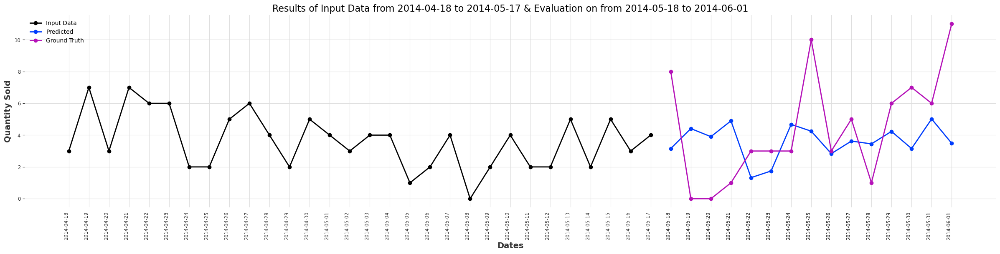

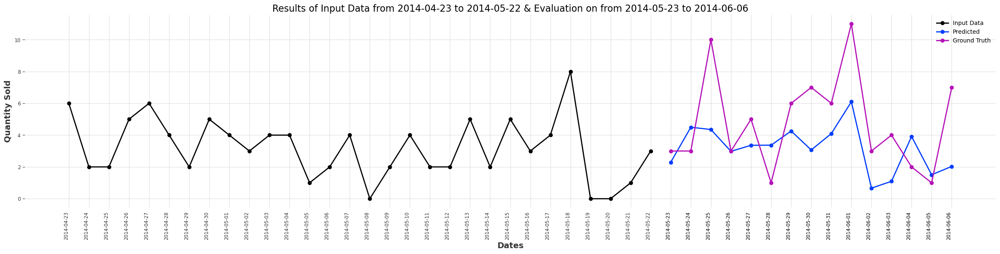

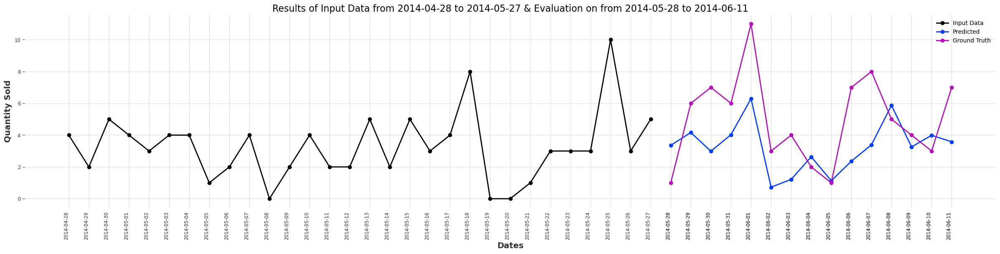

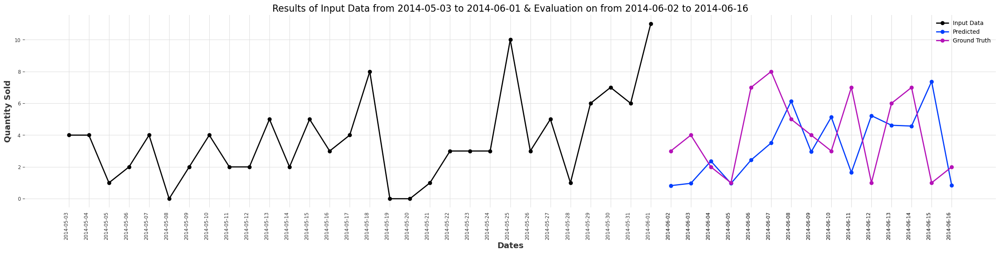

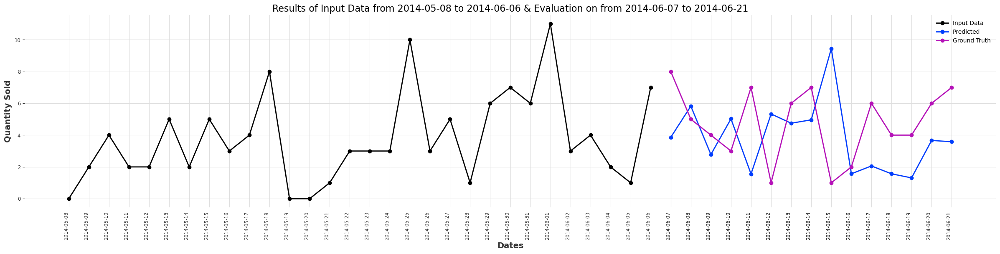

...

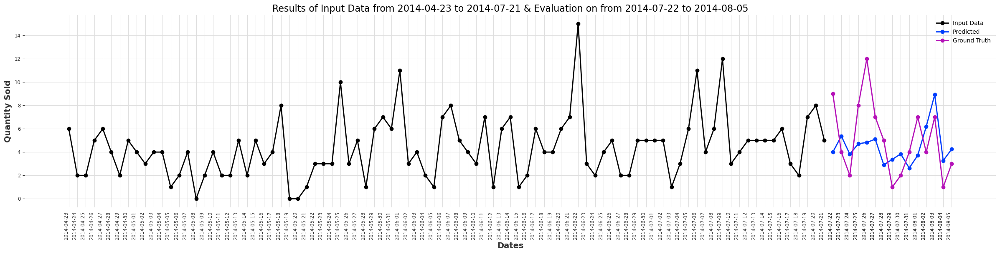

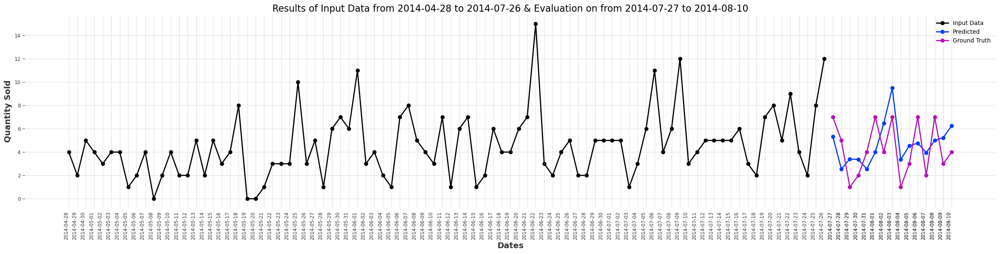

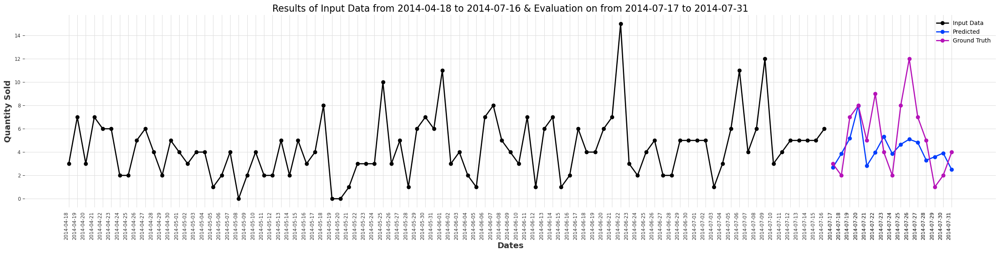

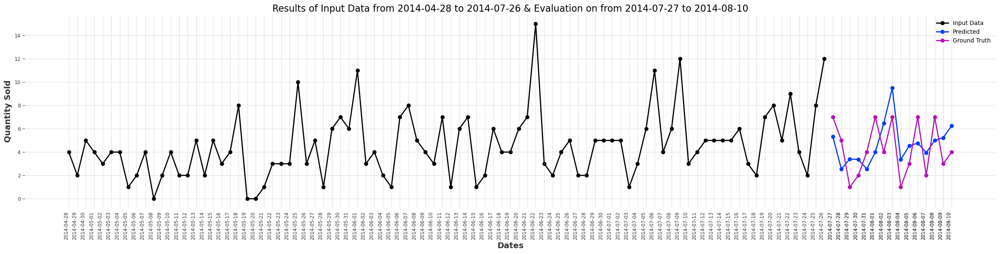

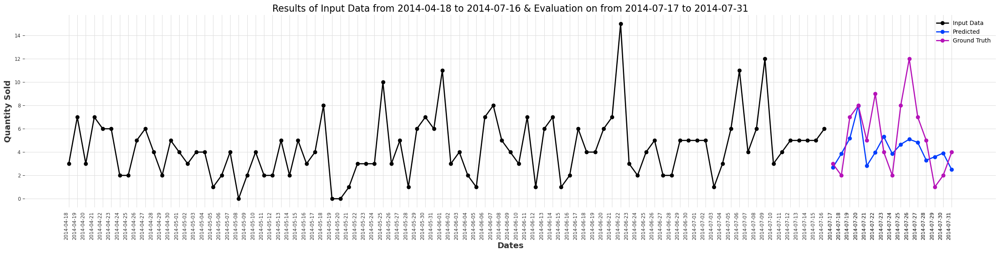

In [14]:
model_name = 'SARIMA'
model_object = sarima_model
FileName = fileName
test_series = test_series 
model_evaluation(model_name,model_object,test_series,FileName)

# Evaluate metrics

In [1]:
import pandas as pd
import glob

def aggregate_evaluation_results(file_pattern):
    eval_dict = {
        'window_size': [],
        'horizan': [],
        'stride': [],
        'AVG_MAE': [],
        'AVG_MSE': [],
        'AVG_RMSE': [],
        'AVG_MAPE': [],
    }
    
    paths = glob.glob(file_pattern)
    
    for path in paths:
        window_size = path.split('/')[-1].split('_')[2]
        horizan = path.split('/')[-1].split('_')[4]
        stride = path.split('/')[-1].split('_')[6].split('.')[0]

        df = pd.read_csv(path)
        eval_dict['window_size'].append(window_size)
        eval_dict['horizan'].append(horizan)
        eval_dict['stride'].append(stride)

        eval_dict['AVG_MAE'].append(df['MAE'].mean())
        eval_dict['AVG_MSE'].append(df['MSE'].mean())
        eval_dict['AVG_RMSE'].append(df['RMSE'].mean())
        eval_dict['AVG_MAPE'].append(df['MAPE'].mean())
    
    eval_df = pd.DataFrame.from_dict(eval_dict)
    eval_df = eval_df.dropna()
    eval_df.sort_values(['window_size', 'horizan', 'stride'], inplace=True, ascending=True)
    
    return eval_df

# Example usage
file_pattern = '../ProcessedData/Results/SARIMA/*.csv'
result_df = aggregate_evaluation_results(file_pattern)
result_df


,window_size,horizan,stride,AVG_MAE,AVG_MSE,AVG_RMSE,AVG_MAPE
5,30,15,10,1.975231,7.223607,2.600361,inf
15,30,15,15,2.105154,8.624195,2.815725,inf
23,30,15,5,2.058373,8.369721,2.794801,inf
14,30,30,10,2.235664,9.268480,3.029288,inf
26,30,30,15,2.307122,9.972929,3.124593,inf
10,30,30,5,2.282880,9.741200,3.098974,inf
16,30,35,10,2.232464,9.223475,3.018732,inf
2,30,35,15,2.263820,9.403375,3.041374,inf
3,30,35,5,2.268868,9.554949,3.073185,inf
8,45,15,10,2.196270,9.326743,3.011505,inf
